In [111]:
import pandas as pd
import math
import numpy as np
from datetime import datetime,date
import pytz
import matplotlib.pyplot as plt
#from IPython.core.ultratb import VerboseTB
#from IPython.display import display, HTML
#display(HTML("<style>.container { width:90% !important; }</style>"))
#VerboseTB._tb_highlight = "bg:#039dfc"
import scipy.optimize as spo
import time
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.utils import plot_model
import requests
import json
#from hyperopt import fmin, tpe, hp, Trials

In [112]:
#print(tf.__version__)
#print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
#tf.test.is_built_with_cuda()


In [113]:
class TechnicalIndicators():
    def __init__(self, data_frame):
        self.df = data_frame.copy()

    # calculation of the return of column after an interval of n days
    def momentum(self, column, n, offset=0):
        if f'{column}_momentum_{n}*' not in self.df.columns:
            close_prices = self.df.loc[offset:,column]
            momentum = close_prices / close_prices.shift(n) - 1
            momentum[0:n]=1
            self.df[f'{column}_momentum_{n}'] = momentum
            
        return self.df[f'{column}_momentum_{n}']
    
    # moving average of column i of returns through n days
    def simple_movement_average(self, column, n, offset=0):
        if f'{column}_sma_{n}*' not in self.df.columns:
            window_mean = self.df.loc[offset:,column].rolling(n).mean()
            window_mean[0:n]=  window_mean[n]
            self.df[f'{column}_sma_{n}'] = self.df[column] / window_mean - 1
        return self.df[f'{column}_sma_{n}']
    
    # calculate upper and lower 2*std_deviation lines
    def _get_bollinger_bands(self, rm, rstd):
        upper_band = rm + rstd * 2
        lower_band = rm - rstd * 2
        return upper_band, lower_band
    
    # moving average and +/- 2*std_deviation lines
    def bollinger_bands(self, column, window_size=20, offset=0):
        if f'{column}_upper_band*' not in self.df.columns:
            self.df[f'{column}_mm20'] = self.df.loc[offset:,column].rolling(window_size).mean()
            self.df.loc[0:window_size,f'{column}_mm20'] =  self.df.loc[window_size,f'{column}_mm20']
            rstd = self.df.loc[offset:,column].rolling(window_size).std()
            rstd.iloc[0:window_size] = rstd.iloc[window_size]
            self.df[f'{column}_upper_band'], self.df[f'{column}_lower_band'] = self._get_bollinger_bands(self.df[f'{column}_mm20'], rstd)
        return self.df[[column, f'{column}_mm20', f'{column}_upper_band', f'{column}_lower_band']]
    
    # daily and cumulative returns of column
    def add_daily_return(self,column):
        self.df[f'{column}_daily_return'] = (self.df[column] / self.df[column].shift(1)) - 1
        self.df.loc[0,f'{column}_daily_return'] = 0
        self.df[f'{column}_cumulative_return'] = (self.df[column] / self.df[column].values[0]) - 1
        self.df.loc[0,f'{column}_cumulative_return'] = 0
        
    # log return after n days of column
    def log_returns(self,column,n):
        self.df[f'{column}_log_return_{n}'] = np.log((self.df[column] / self.df[column].shift(n)))
        self.df.loc[0:n,f'{column}_log_return_{n}'] = self.df.loc[n,f'{column}_log_return_{n}']
        return self.df[f'{column}_log_return_{n}']
    
    

In [114]:
# get stock (ticker) data from yahoo finance from start to end dates
class stock_dataframe():
    def __init__(self,ticker, start=0,end=0):
        self.ticker = ticker
        self.start = start 
        self.end = end

#    def conv_df(resp):
#        j = resp.json()
#        data = [j['chart']['result'][0]['timestamp']] + list(j['chart']['result'][0]['indicators']['quote'][0].values() + list(j['chart']['result'][0]['indicators']['adjclose'][0].values())
#        df = pd.DataFrame(
#        {'timestamp': data[0], 'close': data[1], 'open': data[2], 'high': data[3], 'low': data[4], 'volume': data[5], 'adjclose': data[6]})
#        df['time'] = pd.to_datetime(df['timestamp'], unit='s')
#        df['date'] = df['time'].apply(lambda x: x.strftime('%Y-%m-%d'))
#        return df
        
    def get_yahoo_stock_data(self):
        start_date = date.fromisoformat(self.start)
        end_date = date.fromisoformat(self.end)
        start_stamp = int(datetime(start_date.year, start_date.month, start_date.day, tzinfo=pytz.UTC).timestamp())
        end_stamp = int(datetime(end_date.year, end_date.month, end_date.day, tzinfo=pytz.UTC).timestamp())
        print(start_date, end_date)
        #self.start_stamp = datetime.timestamp(self.start_date)
        #self.end_stamp = datetime.timestamp(self.end_date)
        print(start_stamp,end_stamp)
        url = "https://query2.finance.yahoo.com/v8/finance/chart/%s?period1=%i&period2=%i&interval=1d&events=history&includeAdjustedclose=true" % (self.ticker,start_stamp,end_stamp)
        print(url)
        response = requests.get(url,headers = {'User-agent': 'Request %s' % self.ticker})
        data = response.json()
        result = data["chart"]["result"][0]
        stock = pd.DataFrame(result["indicators"]["quote"][0])
        stock['adjclose'] = result["indicators"]["adjclose"][0]["adjclose"]
        stock['date'] = pd.to_datetime(result["timestamp"], unit='s')
        stock = stock.dropna()
        #print(json.dumps(data, indent=4))
        #data = json.loads(response.text)
        #self.stock = pd.read_csv(url)
       # self.stock = pd.json_normalize(response.json())
        #print(self.stock)
        self.stock = stock.copy()
        self.stock["relhigh"] = stock["high"]/stock["adjclose"]
        self.stock["rellow"] = stock["low"]/stock["adjclose"]
        self.stock["relopen"] = stock["open"]/stock["adjclose"]
        return self.stock
    
    def get_brapi_stock_data(self, RANGE = '3mo', INTERVALO = '1d'):
       
        self.stock = pd.DataFrame()
        API_KEY = 'gjx1h4PNSzSAJFqmzgsteD' 
        for ATIVO in self.ticker:
            #time.sleep(1)  # Aguarda 1 segundo entre as requisições para evitar sobrecarga no servidor
            # URL da API brapi
            URL = f"https://brapi.dev/api/quote/{ATIVO}?range={RANGE}&interval={INTERVALO}&token={API_KEY}"

            
            #try:
            response = requests.get(URL)
            response.raise_for_status() # Lança um erro para códigos de status 4xx/5xx
            #except:
            #    self.ticker.remove(ATIVO)
            #    continue
            print(f"Buscando dados diários para o ativo: {ATIVO}...")

            # Converte a resposta JSON
            data = response.json()
            # --- 2. Extração dos Dados ---
            # O JSON da brapi contém os dados da série histórica dentro de 'results'[0]['historicalData']
            # Verifica se 'historicalData' existe
            historical_data = pd.DataFrame(data['results'][0].get('historicalDataPrice'))
            #print("stock data", historical_data)
            
            historical_data["relhigh"] = historical_data["high"]/historical_data["close"]
            historical_data["rellow"] = historical_data["low"]/historical_data["close"]
            historical_data["relopen"] = historical_data["open"]/historical_data["close"]
            historical_data['date'] = pd.to_datetime(historical_data["date"], unit='s')
            #print (historical_data)
            if self.stock.empty:
                self.stock = historical_data.add_prefix(ATIVO+"_")
                self.stock.rename(columns={ATIVO+"_date": "date"}, inplace=True)
            else:
            #    print(self.stock)
                self.stock = pd.merge(self.stock,historical_data.add_prefix(ATIVO+"_"), left_on="date", right_on=ATIVO+"_date")
                #print(self.stock)
                #self.stock.drop(ATIVO+"_date")
        self.stock['date'] = pd.to_datetime(self.stock["date"], unit='s')

        self.stock = self.stock.dropna()
        
        return self.stock   
    # Convert Date to Day, Month and Year columns.
    def Date_Convert(self):
        self.stock['date'] = pd.to_datetime(self.stock['date'])
        self.stock['year'] = self.stock['date'].dt.year
        self.stock['month'] = self.stock['date'].dt.month
        self.stock['day'] = self.stock['date'].dt.day
        if self.stock['date'].isna().any():
            print("NaN values found in 'date' column.")
            print("stock = ", self.ticker)
            print(self.stock[self.stock['date'].isna()])
        
    # define Scaler
    def Standard_Scaler(self):
        self.scaler = StandardScaler()
    
    def Min_Max_Scaler(self):
        self.scaler = MinMaxScaler()
        
    # Calculate technical indicators    
    def Get_Technical_Indicators(self,price):
        TI = TechnicalIndicators(self.stock)
        TI.momentum(price,15)
        TI.simple_movement_average(price,15)
        TI.bollinger_bands(price,15)
        TI.add_daily_return(price)
        TI.log_returns(price,1)
        TI.log_returns(price,7)
        self.stock = TI.df
        return self.stock
        
    # Perform Chosen normalization    
    def Normalize(self):
        # Copy the DataFrame
        stock_normalized = self.stock.copy()

        # Apply StandardScaler to the subset of columns
        stock_normalized = (self.stock - self.stock.mean())/self.stock.std()

        return stock_normalized



In [115]:
# Class for calculating option weights for an optimal portfolio for each day 
class PortfolioOptimization:
    def __init__(self, data_frame, options):
        self.df = data_frame.copy()
        self.options = options.copy()
        self.init_weights()

     # initialize weights        
    def init_weights(self):
        for stock in self.options:
            if f'{stock}_weight' not in self.df.columns:
                self.df[f"{stock}_weight"] = 1 / len(self.options)

    # constraints for optimization. Might not be needed in case W_i/sum(W_i) is used             
    def _constraints(self, weights):
        return np.sum(weights) - 1
    
    # Sharpe ration calculation of the full portfolio. Currently using constant as risk free return
    def sharpe_ratio(self, weights, returns, std, rfree):
        norm_weights = weights / np.sum(weights)
        total_return = np.sum(norm_weights * returns)
        portfolio_stddev = np.sum(norm_weights*norm_weights*std*std)
        return (total_return - rfree) / portfolio_stddev
    
    # Minimize target funcion, maximizing the Sharpe ratio
    def target_function(self, weights, returns, stddev, rfree):
        return -self.sharpe_ratio(weights, returns, stddev, rfree)

    # weight optimization using scikit.optmize.minimize. Might not be the best choice, still can test alternatives. Need to check optimized values 
    def optimize_weights(self, weights, returns, stddev, rfree):
        constraints = {'type': 'eq', 'fun': self._constraints}
        bounds = [(0, 1) for _ in range(len(weights))]

        result = spo.minimize(
            self.target_function,
            weights,
            args=(returns, stddev, rfree),
            constraints=constraints,
            bounds=bounds,
            method='SLSQP'  # Sequential Least Squares Programming optimizer
        )
        
        if not result.success:
            raise ValueError(f"Optimization failed: {result.message}")

        return result.x
    
    # Apply optimization for each row. 
    def get_optimal_weights(self, rfree=0.0001):
        weight_columns = [col for col in self.df.columns if col.endswith('_weight')]
        return_columns = [col.replace('_weight', '_adjclose_log_return_1') for col in weight_columns]
        stddev_columns = [self.df[col].std() for col in return_columns]

        def apply_optimization(row):
            weights = row[weight_columns].values
            returns = row[return_columns].values
            optimal_weights = self.optimize_weights(weights, returns, stddev_columns, rfree)
            return pd.Series(optimal_weights, index=weight_columns)

        # df.apply was tricky to use with a function with many parameters, to be applied in many columns. This was the workaround which worked  
        self.df[weight_columns] = self.df.apply(apply_optimization, axis=1)
        return self.df[weight_columns]

In [116]:

def merge_stocks(options):
    df = pd.DataFrame()
    for stock in options:
        #print("stock =",stock)
        # define stock data class
        stock_data = stock_dataframe(stock,"2020-08-31","2025-11-21")

        # read data
        stock_data.get_yahoo_stock_data()

        # convert Date to Day, Month and Year columns
        stock_data.Date_Convert()

        # Calculate additional variables
        stock_data.Get_Technical_Indicators("adjclose")

        #print("stock_data.stock = ",stock_data.stock)
        # Apply normalization
        date_columns = ["date","year","month","day"]
        df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()
        # Identify columns with identical values across all DataFrames
        identical_columns = []
        distinct_columns = []

        # merge with other options
        for col in df_stock.columns:
            if (col in df and col in df_stock):
                if df[col].equals(df_stock[col]): identical_columns.append(col)
            else:
                if col not in date_columns: df_stock.rename(columns={col: stock + '_' + col}, inplace=True)
        # Identify columns with distinct values across the DataFrames
        distinct_columns = [col for col in df_stock.columns if col not in identical_columns]

        df = pd.concat([df,df_stock[distinct_columns]],axis=1)
    #print(df)
    return df

In [117]:
class data_prep(): 
    def __init__(
        self, 
        df, 
        features, 
        targets, 
        train_fraction=0.5, 
        validation_fraction=0.25, 
        rwin=7, 
        offset=1, 
    ):
        self.df = df.copy()
        self.features = features.copy()
        self.targets = targets.copy()
        self.train_fraction = train_fraction
        self.validation_fraction = validation_fraction
        self.rwin = rwin
        self.offset = offset

    def calculate_metrics(self):
        Met = Metrics(self.Train_Dat[self.targets],self.Train_Pred[self.targets],self.targets)
        self.train_pull  = M_Train.pull()
        self.train_chisq = M_Train.chisq()
        self.train_mse   = M_Train.get_mse()

        return self
    
    def create_sequences(self):
        self.sequences = []
        self.featureval = self.df[self.features].values
        for start_idx in range(len(self.featureval) - self.rwin + 1):
            end_idx = start_idx + self.rwin
            sequence = self.featureval[start_idx:end_idx]
            self.sequences.append(sequence)
            
        return self.sequences

    def create_targetval(self):
        self.targetval = self.df[self.targets].values
        return self.targetval
    
    def split_data(self):
        train_split = int((len(self.targetval) - self.rwin)*self.train_fraction)
        validation_split = int((len(self.targetval) - self.rwin)*self.validation_fraction)
        train_sequences = self.sequences[:train_split]
        validation_sequences = self.sequences[train_split:train_split + validation_split]
        test_sequences = self.sequences[train_split + validation_split:]
        train_targets = self.targetval[self.rwin+self.offset:self.rwin+self.offset + train_split]
        validation_targets = self.targetval[self.rwin+self.offset + train_split:self.rwin+self.offset + train_split + validation_split]
        test_targets = self.targetval[self.rwin+self.offset + train_split + validation_split:]
        print("len(self.sequences) = ", len(self.sequences))
        print("len(self.targetval) = ", len(self.targetval))
        print("self.rwin = ", self.rwin)
        print("self.train_fraction = ", self.train_fraction)
        print("self.validation_fraction = ", self.validation_fraction)
        print("train_split = ", train_split)
        print("valdation_split = ", validation_split)
        return train_sequences, validation_sequences, test_sequences, train_targets, validation_targets, test_targets
        

In [118]:
# class for calculating evaluation metrics of the model
class Metrics():
    def __init__(self, in_df, pred_df, targets):
        common_indices = in_df.index.intersection(pred_df.index)
        common_indices = common_indices[:-1]
        self.in_df = in_df.loc[common_indices].copy()
        self.pred_df = pred_df.loc[common_indices].copy()
        self.targets = targets.copy()
        self.out = pd.DataFrame()
        self.mse = {}

    # pull = (predicted - data)/std_dev    
    def pull(self):
        for column in self.targets:
            # Ensure both return Series
            in_series = self.in_df[column].squeeze()
            pred_series = self.pred_df[column].squeeze()
            diff = pred_series - in_series
            in_std = self.in_df[column].std()
            pred_std = self.in_df[column].std()
            pull = diff/math.sqrt(pow(in_std,2) + pow(pred_std,2))
            self.out[f'{column}_Pull'] = pull
        return self.out.filter(like='Pull')

    # chisq = (predicted - data)**2/std_dec**2
    def chisq(self):
        for column in self.targets:
            in_series = self.in_df[column].squeeze()
            pred_series = self.pred_df[column].squeeze()
            diff = pred_series - in_series
            in_std = self.in_df[column].std()
            pred_std = self.in_df[column].std()
            chisq = diff*diff/(pow(in_std,2) + pow(pred_std,2))
            self.out[f'{column}_ChiSq'] = chisq
        return self.out.filter(like='ChiSq')
    
    # mse = sum(chisq)/n_rows for every row
    def get_mse(self):
        for column in self.targets:
            if f'{column}_ChiSq' not in self.out.columns:
                self.chisq()
            self.mse[column] = self.out[f'{column}_ChiSq'].sum()/len(self.out[f'{column}_ChiSq'])
            return self.mse

In [119]:
class model_builder():
    def __init__(
        self,
        df,
        features,
        targets,
        offset
    ):
        self.df = df
        self.features = features
        self.targets = targets
        self.offset = offset

    def set_space(self):
        self.space = {
            'nlstmlayers': hp.quniform('nlstmlayers', 1, 3, 1),
            'ndenselayers': hp.quniform('ndenselayers', 1, 3, 1),
            'rwin': hp.quniform('rwin', 5, 90, 5),
            'lstmunits': hp.quniform('lstmunits', len(self.features), len(self.features)*10, len(self.features)),
            'denseunits': hp.quniform('denseunits', len(self.targets), len(self.features), 1),
            'activation': hp.choice('activation', ['relu', 'tanh', 'linear']),
            'optimizer': hp.choice('optimizer', ['adam', 'sgd']),
            'epochs': hp.quniform('epochs',1,101,10),
            'batch': hp.quniform('batch', 1, 5, 1)
        }
        return self.space

    def build_eval(self,params):
        begin = time.time()
        nlstmlayers = int(params['nlstmlayers'])
        ndenselayers = int(params['ndenselayers'])
        lstmunits = int(params['lstmunits'])
        denseunits = int(params['denseunits'])
        activation = params['activation']
        optimizer = params['optimizer']
        epochs = int(params['epochs'])
        batch =int( pow(2,params['batch']))
        rwin =int(params['rwin'])

        dp = data_prep(self.df,self.features, self.targets, rwin = rwin, offset = self.offset)
        self.sequences = dp.create_sequences()
        self.targetvals = dp.create_targetval()

        train_sequences, validation_sequences, test_sequences, train_targets, validation_targets, test_targets = dp.split_data()

        model = Sequential()

        print(params)

        #print('train_sequences.shape=',train_sequences.shape)


        for L in range(nlstmlayers):
            #print('L = ', L, 'nlstmlayers = ', nlstmlayers)
            if L == (nlstmlayers-1) : model.add(LSTM(lstmunits, activation=activation, input_shape=(rwin, len(self.features)), return_sequences=False))
            else: model.add(LSTM(lstmunits, activation=activation, input_shape=(rwin, len(self.features)), return_sequences=True))

        for L in range(ndenselayers):
            model.add(Dense(denseunits, activation = activation))

        model.add(Dense(len(self.targets), activation = activation))
        model.compile(optimizer=optimizer, loss='mse')
        print(model.summary())
        config = model.get_config()
        #print("input",config["layers"][0]["config"]["batch_input_shape"])
        model.fit(train_sequences, train_targets, epochs=epochs, verbose=0,batch_size = batch)
        loss = model.evaluate(validation_sequences, validation_targets, verbose=0)

        end = time.time()
        print('iteration lasted', end-begin)

        return loss


In [120]:

#options = [
#           "ITUB4.SA",
#           "VALE3.SA"
#          ]
options = [
              "ALOS3", "ABEV3", "ASAI3", "AURE3", "AXIA3", "AXIA6", "AZZA3", "B3SA3", "BBSE3", "BBDC3",
    "BBDC4", "BRAP4", "BBAS3", "BRKM5", "BRAV3", "BPAC11", "CXSE3", "CEAB3", "CMIG4", "COGN3",
    "CPLE5", "CSAN3", "CPFE3", "CMIN3", "CURY3", "CVCB3", "CYRE3", "DIRR3", "EMBJ3", "ENGI11",
    "ENEV3", "EGIE3", "EQTL3", "FLRY3", "GGBR4", "GOAU4", "HAPV3", "HYPE3", "IGTI11", "IRBR3",
    "ISAE4", "ITSA4", "ITUB4", "KLBN11", "RENT3", "LREN3", "MGLU3", "POMO4", "MBRF3", "BEEF3",
    "MOTV3", "MRVE3", "MULT3", "NATU3", "PCAR3", "PETR3", "PETR4", "RECV3", "PRIO3", "PSSA3",
    "RADL3", "RAIZ4", "RDOR3", "RAIL3", "SBSP3", "SANB11", "CSNA3", "SLCE3", "SMFT3", "SUZB3",
    "TAEE11", "VIVT3", "TIMS3", "TOTS3", "UGPA3", "USIM5", "VALE3", "VAMO3", "VBBR3", "VIVA3",
    "WEGE3", "YDUQ3"
]
options = [stock+".SA" for stock in options]
prices = [stock+"_adjclose_log_return_1" for stock in options]
features = ["VALE3.SA_adjClose_log_return_1","ITUB4.SA_adjClose_log_return_1"]
targets = ["VALE3.SA_adjClose_log_return_1","ITUB4.SA_adjClose_log_return_1"]
stocks = merge_stocks(options)
#df_stocks = stocks.get_brapi_stock_data(RANGE='3mo',INTERVALO='1d')    


#print("Options after data fetch:", options)
# convert Date to Day, Month and Year columns
#stocks.Date_Convert()
#print(stocks.stock)
#for option in options:
#    stocks.Get_Technical_Indicators(option+"_adjClose")
#df_stocks = stocks.Normalize()
print(stocks)

       


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/ALOS3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/ABEV3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/ASAI3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/AURE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/AXIA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/AXIA6.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/AZZA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/B3SA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BBSE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BBDC3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BBDC4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BRAP4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BBAS3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BRKM5.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BRAV3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BPAC11.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CXSE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CEAB3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CMIG4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/COGN3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CPLE5.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CSAN3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CPFE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CMIN3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CURY3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CVCB3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CYRE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/DIRR3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/EMBJ3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/ENGI11.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/ENEV3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/EGIE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/EQTL3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/FLRY3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/GGBR4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/GOAU4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/HAPV3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/HYPE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/IGTI11.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/IRBR3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/ISAE4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/ITSA4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/ITUB4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/KLBN11.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/RENT3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/LREN3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/MGLU3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/POMO4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/MBRF3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BEEF3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/MOTV3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/MRVE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/MULT3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/NATU3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/PCAR3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/PETR3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/PETR4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/RECV3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/PRIO3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/PSSA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/RADL3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/RAIZ4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/RDOR3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/RAIL3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/SBSP3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/SANB11.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CSNA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/SLCE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/SMFT3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/SUZB3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/TAEE11.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/VIVT3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/TIMS3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/TOTS3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/UGPA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/USIM5.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/VALE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/VAMO3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/VBBR3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/VIVA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/WEGE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/YDUQ3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true
     ALOS3.SA_high ALOS3.SA_open ALOS3.SA_volume ALOS3.SA_close ALOS3.SA_low  \
0          1.30587      1.367487       -0.581453         1.1656     1.227662   
1         1.441522      1.265314       -0.721388       1.446701     1.337897   
2         1.447295      1.504691       -1.042878       1.496479      1.49878   
3         1.432863      1.475499       -0.953657       1.350072     1.385566   
4         1.372253      1.329537         -0.9133       1.452557     1.251496   
...            ...           ...             ...            ...          ...   
1299      1.764777      1.857919        0.776906       1.625317     1.737126   
1300      1.493474      1.595187        0.364395       1.596036     1.647746   
1301      1.354936      1.460903       -0.003724        1.43206     1.519635   
410   

C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


In [121]:
print(stocks.columns[~stocks.isna().any(axis=0)])

Index(['ABEV3.SA_volume', 'ABEV3.SA_low', 'ABEV3.SA_close', 'ABEV3.SA_open',
       'ABEV3.SA_high', 'ABEV3.SA_adjclose', 'date', 'ABEV3.SA_relhigh',
       'ABEV3.SA_rellow', 'ABEV3.SA_relopen',
       ...
       'day', 'YDUQ3.SA_adjclose_momentum_15', 'YDUQ3.SA_adjclose_sma_15',
       'YDUQ3.SA_adjclose_mm20', 'YDUQ3.SA_adjclose_upper_band',
       'YDUQ3.SA_adjclose_lower_band', 'YDUQ3.SA_adjclose_daily_return',
       'YDUQ3.SA_adjclose_cumulative_return', 'YDUQ3.SA_adjclose_log_return_1',
       'YDUQ3.SA_adjclose_log_return_7'],
      dtype='object', length=1408)


In [122]:
# diagnostics
print('Rows:', len(stocks))
print('Cols:', len(stocks.columns))
nan_counts = stocks.isna().sum().sort_values(ascending=False)
print('Columns with NaNs (count):')
print(nan_counts[nan_counts > 0])

# columns that have NO NaNs
cols_without_any_nan = stocks.columns[~stocks.isna().any(axis=0)]
print('Number of clean columns:', len(cols_without_any_nan))

# keep only clean columns and reset index
df_stocks = stocks.loc[:, cols_without_any_nan].reset_index(drop=True)

Rows: 1302
Cols: 1804
Columns with NaNs (count):
year                                   1302
year                                   1302
year                                   1302
EMBJ3.SA_adjclose_log_return_7         1284
EMBJ3.SA_adjclose_lower_band           1284
                                       ... 
CPLE5.SA_volume                           1
CPLE5.SA_adjclose_log_return_7            1
CPLE5.SA_adjclose_log_return_1            1
CPLE5.SA_adjclose_cumulative_return       1
CPLE5.SA_adjclose_daily_return            1
Length: 396, dtype: int64
Number of clean columns: 1408


In [123]:
df_stocks = stocks
df_stocks_nonancolumns = df_stocks.columns[df_stocks.notna().all(axis=0)]
print( df_stocks_nonancolumns.isin(["MOTV3.SA_adjclose_log_return_1"]))
print(len(df_stocks))
print(len(df_stocks.columns))
print(len(df_stocks_nonancolumns))
print(df_stocks_nonancolumns)

[False False False ... False False False]
1302
1804
1408
Index(['ABEV3.SA_volume', 'ABEV3.SA_low', 'ABEV3.SA_close', 'ABEV3.SA_open',
       'ABEV3.SA_high', 'ABEV3.SA_adjclose', 'date', 'ABEV3.SA_relhigh',
       'ABEV3.SA_rellow', 'ABEV3.SA_relopen',
       ...
       'day', 'YDUQ3.SA_adjclose_momentum_15', 'YDUQ3.SA_adjclose_sma_15',
       'YDUQ3.SA_adjclose_mm20', 'YDUQ3.SA_adjclose_upper_band',
       'YDUQ3.SA_adjclose_lower_band', 'YDUQ3.SA_adjclose_daily_return',
       'YDUQ3.SA_adjclose_cumulative_return', 'YDUQ3.SA_adjclose_log_return_1',
       'YDUQ3.SA_adjclose_log_return_7'],
      dtype='object', length=1408)


In [124]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None): print(df_stocks['MOTV3.SA_adjclose_log_return_1'])

0       0.059596
1       0.059596
2       0.583096
3      -0.360137
4        0.63082
5       0.725687
6         2.5637
7      -2.812343
8      -0.458432
9      -0.356807
10      0.313797
11     -1.239072
12     -1.099002
13      1.887564
14       0.15844
15     -1.028937
16      1.291972
17      0.409314
18       0.85634
19     -2.022208
20     -0.510588
21      0.569363
22      0.360035
23      1.656803
24      0.197802
25     -1.543773
26     -1.113272
27     -0.508749
28      0.311341
29      0.156341
30     -0.251617
31     -0.868401
32     -0.357194
33      0.417305
34      0.311341
35     -0.508749
36     -0.253102
37      1.177501
38      0.304737
39      0.001789
40     -1.161256
41     -0.507836
42      1.423169
43      -1.36459
44      0.511831
45     -0.556095
46      1.314418
47      0.100827
48     -1.304641
49      0.506901
50      0.302096
51     -0.600071
52     -0.603742
53      -0.86328
54     -1.339952
55      -1.46912
56     -0.365395
57      1.746834
58     -1.3588

['ABEV3.SA_adjclose_log_return_1', 'AXIA3.SA_adjclose_log_return_1', 'AXIA6.SA_adjclose_log_return_1', 'AZZA3.SA_adjclose_log_return_1', 'B3SA3.SA_adjclose_log_return_1', 'BBSE3.SA_adjclose_log_return_1', 'BBDC3.SA_adjclose_log_return_1', 'BBDC4.SA_adjclose_log_return_1', 'BRAP4.SA_adjclose_log_return_1', 'BBAS3.SA_adjclose_log_return_1', 'BRKM5.SA_adjclose_log_return_1', 'BPAC11.SA_adjclose_log_return_1', 'CEAB3.SA_adjclose_log_return_1', 'CMIG4.SA_adjclose_log_return_1', 'COGN3.SA_adjclose_log_return_1', 'CSAN3.SA_adjclose_log_return_1', 'CPFE3.SA_adjclose_log_return_1', 'CVCB3.SA_adjclose_log_return_1', 'CYRE3.SA_adjclose_log_return_1', 'DIRR3.SA_adjclose_log_return_1', 'ENGI11.SA_adjclose_log_return_1', 'ENEV3.SA_adjclose_log_return_1', 'EGIE3.SA_adjclose_log_return_1', 'EQTL3.SA_adjclose_log_return_1', 'FLRY3.SA_adjclose_log_return_1', 'GGBR4.SA_adjclose_log_return_1', 'GOAU4.SA_adjclose_log_return_1', 'HAPV3.SA_adjclose_log_return_1', 'HYPE3.SA_adjclose_log_return_1', 'IRBR3.SA_a

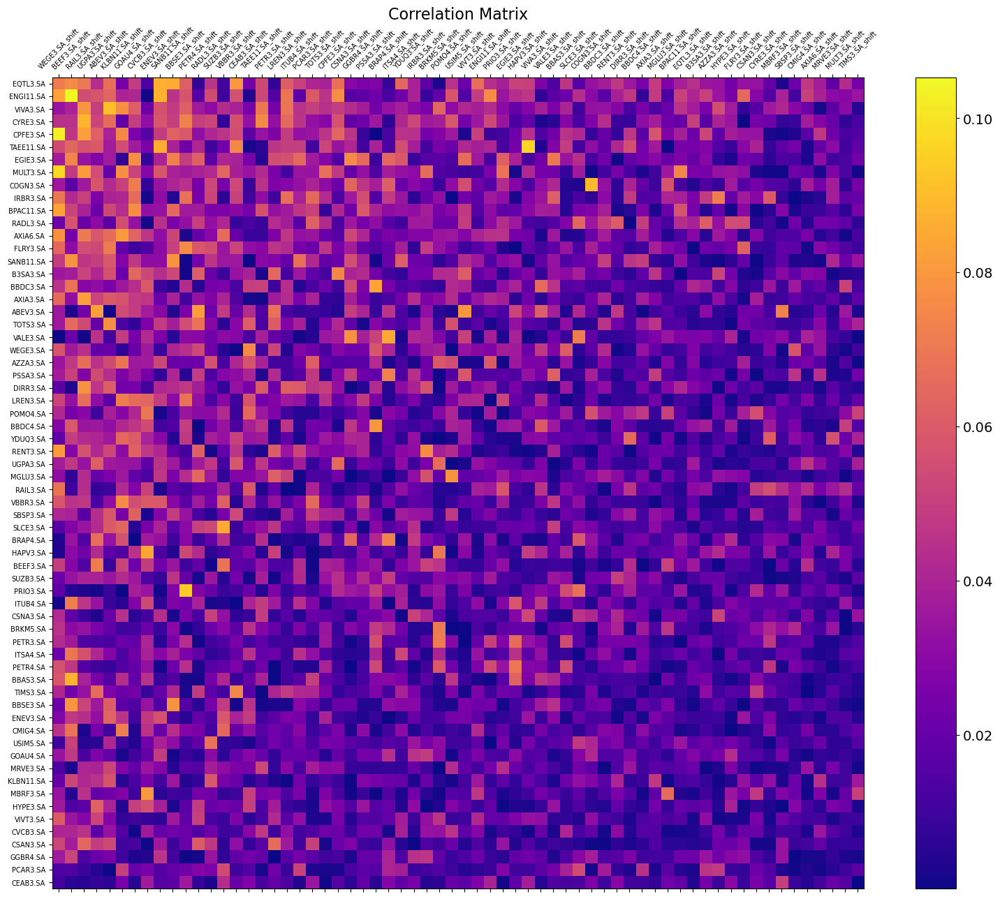

In [127]:
nonan_df_stocks = df_stocks[df_stocks_nonancolumns]
# list columns that contain any NaN values (avoid boolean reindex warning)
#df_stocks = df_stocks.dropna()
prices = [price for price in nonan_df_stocks.columns if price.endswith("_adjclose_log_return_1")]
nonan_df_stocks = nonan_df_stocks.reset_index(drop=True)
print(prices)
print(df_stocks)
nonan_df_stocks = nonan_df_stocks[prices]
nonan_df_stocks_shifted = nonan_df_stocks.shift(-1)
nonan_df_stocks.columns = [col.replace("_adjclose_log_return_1","") for col in nonan_df_stocks.columns]
nonan_df_stocks_shifted.columns = [col.replace("_adjclose_log_return_1","_shift") for col in nonan_df_stocks_shifted.columns]

corr_matrix =  pd.DataFrame(
    {col_j: nonan_df_stocks.corrwith(nonan_df_stocks_shifted[col_j], axis=0) for col_j in nonan_df_stocks_shifted.columns}
)

row_order = corr_matrix.abs().sum(axis=1).sort_values(ascending=False).index
col_order = corr_matrix.abs().sum(axis=0).sort_values(ascending=False).index

corr_matrix = corr_matrix.loc[row_order, col_order].abs()
print(nonan_df_stocks)
print(corr_matrix)
print(corr_matrix)
cmap = plt.colormaps["plasma"] # Colour map (there are many others)
f = plt.figure(figsize=(19, 15))
plt.matshow(corr_matrix, fignum=f.number, cmap=cmap)
plt.xticks(range(corr_matrix.select_dtypes(['number']).shape[1]), corr_matrix.select_dtypes(['number']).columns , fontsize=7
           , rotation=45)
plt.yticks(range(corr_matrix.select_dtypes(['number']).shape[1]), corr_matrix.select_dtypes(['number']).index , fontsize=7
           , rotation=0)
cb = plt.colorbar(cmap=cmap)
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

prices = ['ABEV3.SA_adjclose_log_return_7', 'AXIA3.SA_adjclose_log_return_7', 'AXIA6.SA_adjclose_log_return_7', 'AZZA3.SA_adjclose_log_return_7', 'B3SA3.SA_adjclose_log_return_7', 'BBSE3.SA_adjclose_log_return_7', 'BBDC3.SA_adjclose_log_return_7', 'BBDC4.SA_adjclose_log_return_7', 'BRAP4.SA_adjclose_log_return_7', 'BBAS3.SA_adjclose_log_return_7', 'BRKM5.SA_adjclose_log_return_7', 'BPAC11.SA_adjclose_log_return_7', 'CEAB3.SA_adjclose_log_return_7', 'CMIG4.SA_adjclose_log_return_7', 'COGN3.SA_adjclose_log_return_7', 'CSAN3.SA_adjclose_log_return_7', 'CPFE3.SA_adjclose_log_return_7', 'CVCB3.SA_adjclose_log_return_7', 'CYRE3.SA_adjclose_log_return_7', 'DIRR3.SA_adjclose_log_return_7', 'ENGI11.SA_adjclose_log_return_7', 'ENEV3.SA_adjclose_log_return_7', 'EGIE3.SA_adjclose_log_return_7', 'EQTL3.SA_adjclose_log_return_7', 'FLRY3.SA_adjclose_log_return_7', 'GGBR4.SA_adjclose_log_return_7', 'GOAU4.SA_adjclose_log_return_7', 'HAPV3.SA_adjclose_log_return_7', 'HYPE3.SA_adjclose_log_return_7', 'I

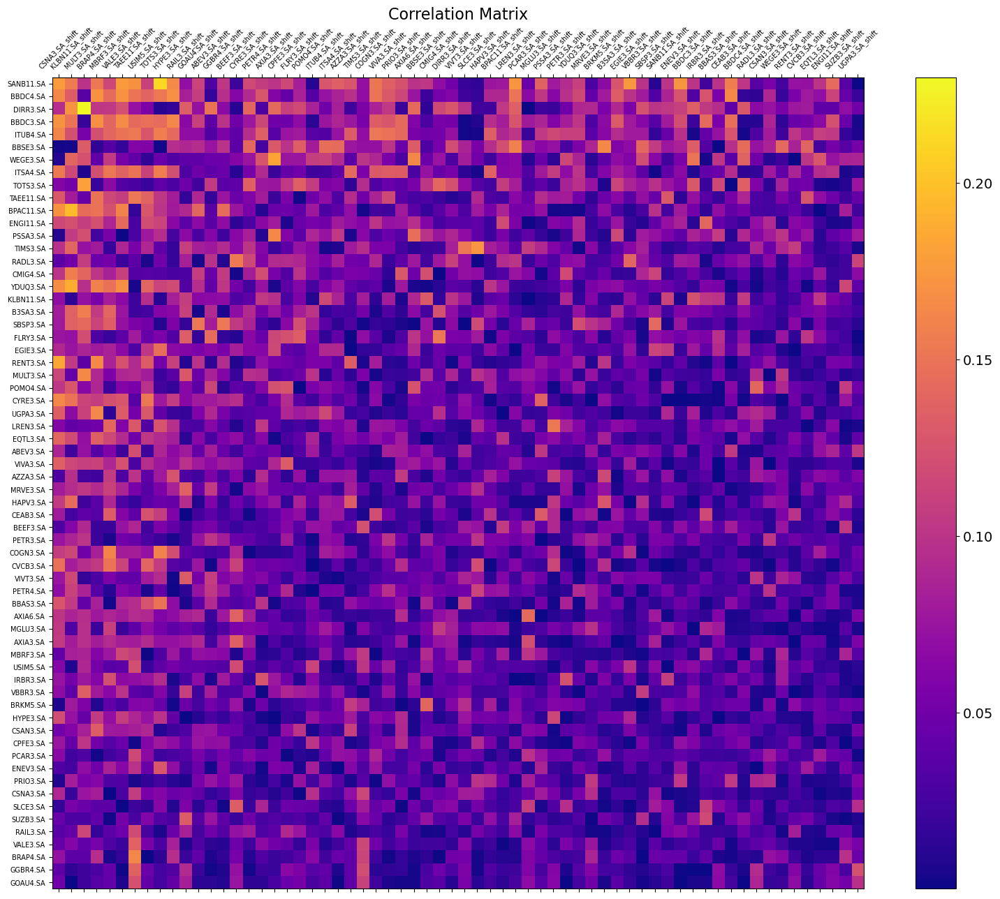

In [128]:
df_stocks_nonancolumns = df_stocks.columns[df_stocks.notna().all(axis=0)]
nonan_df_stocks = df_stocks[df_stocks_nonancolumns]
# list columns that contain any NaN values (avoid boolean reindex warning)
#df_stocks = df_stocks.dropna()
prices = [price for price in nonan_df_stocks.columns if price.endswith("_adjclose_log_return_7")]
print("prices =", prices)
nonan_df_stocks = nonan_df_stocks.reset_index(drop=True)
#print(df_stocks)
nonan_df_stocks = nonan_df_stocks[prices]
print(nonan_df_stocks)
nonan_df_stocks_shifted = nonan_df_stocks.shift(-7)
nonan_df_stocks.columns = [col.replace("_adjclose_log_return_7","") for col in nonan_df_stocks.columns]
nonan_df_stocks_shifted.columns = [col.replace("_adjclose_log_return_7","_shift") for col in nonan_df_stocks_shifted.columns]

corr_matrix =  pd.DataFrame(
    {col_j: nonan_df_stocks.corrwith(nonan_df_stocks_shifted[col_j], axis=0) for col_j in nonan_df_stocks_shifted.columns}
)

row_order = corr_matrix.abs().sum(axis=1).sort_values(ascending=False).index
col_order = corr_matrix.abs().sum(axis=0).sort_values(ascending=False).index

corr_matrix = corr_matrix.loc[row_order, col_order].abs()
print(nonan_df_stocks)
print(corr_matrix)
print(corr_matrix)
cmap = plt.colormaps["plasma"] # Colour map (there are many others)
f = plt.figure(figsize=(19, 15))
plt.matshow(corr_matrix, fignum=f.number, cmap=cmap)
plt.xticks(range(corr_matrix.select_dtypes(['number']).shape[1]), corr_matrix.select_dtypes(['number']).columns , fontsize=7
           , rotation=45)
plt.yticks(range(corr_matrix.select_dtypes(['number']).shape[1]), corr_matrix.select_dtypes(['number']).index , fontsize=7
           , rotation=0)
cb = plt.colorbar(cmap=cmap)
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

In [80]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None): print(df_stocks['MOTV3.SA_adjclose_log_return_1'])

KeyError: 'MOTV3.SA_adjclose_log_return_1'

In [129]:
corr_matrix.columns = [col.replace("_shift","") for col in corr_matrix.columns]
print(corr_matrix)

           CSNA3.SA  KLBN11.SA  MULT3.SA  BRAP4.SA  MBRF3.SA  VALE3.SA  \
SANB11.SA  0.177059   0.156013  0.099381  0.153320  0.116391  0.176533   
BBDC4.SA   0.163820   0.132184  0.035285  0.171331  0.143250  0.171278   
DIRR3.SA   0.094582   0.171823  0.230001  0.102678  0.104009  0.122924   
BBDC3.SA   0.171297   0.148355  0.017737  0.169723  0.139160  0.166989   
ITUB4.SA   0.161864   0.122677  0.053141  0.121616  0.139469  0.149737   
...             ...        ...       ...       ...       ...       ...   
RAIL3.SA   0.035107   0.043435  0.115885  0.016643  0.037614  0.047934   
VALE3.SA   0.043380   0.061440  0.041092  0.053691  0.030625  0.019098   
BRAP4.SA   0.071111   0.037921  0.038575  0.095298  0.005209  0.016853   
GGBR4.SA   0.040233   0.013960  0.020741  0.029452  0.042811  0.001319   
GOAU4.SA   0.050564   0.000849  0.021535  0.034798  0.042587  0.006835   

           TAEE11.SA  USIM5.SA  TOTS3.SA  HYPE3.SA  ...  BBDC4.SA  RADL3.SA  \
SANB11.SA   0.170016  0.111945  

In [130]:
#print(corr_matrix)
best_pairs = {}
best_options = []
for col in corr_matrix.columns:
   #print(f"Analyzing column: {col}")
   for row in corr_matrix.index:
       if col != row:
            #print(f"Checking pair: {row} and {col}")
            corr_value = corr_matrix.loc[row, col]
            if abs(corr_value) > 0.06:
                best_pairs[(row, col)] = corr_value
            if row not in best_options and abs(corr_value) > 0.06:
                best_options.append(row)
            if col not in best_options and abs(corr_value) > 0.06:
                best_options.append(col)
print(len(best_pairs))
print(best_pairs)
print(len(best_options))
print(best_options) 

1396
{('SANB11.SA', 'CSNA3.SA'): np.float64(0.1770589616746712), ('BBDC4.SA', 'CSNA3.SA'): np.float64(0.1638196171294002), ('DIRR3.SA', 'CSNA3.SA'): np.float64(0.09458168080358532), ('BBDC3.SA', 'CSNA3.SA'): np.float64(0.17129721493770977), ('ITUB4.SA', 'CSNA3.SA'): np.float64(0.1618635232575782), ('ITSA4.SA', 'CSNA3.SA'): np.float64(0.1537240044449073), ('TOTS3.SA', 'CSNA3.SA'): np.float64(0.061950201504916376), ('TAEE11.SA', 'CSNA3.SA'): np.float64(0.12881384677661842), ('BPAC11.SA', 'CSNA3.SA'): np.float64(0.17039134437762157), ('ENGI11.SA', 'CSNA3.SA'): np.float64(0.11599723375501612), ('TIMS3.SA', 'CSNA3.SA'): np.float64(0.0978557023751651), ('CMIG4.SA', 'CSNA3.SA'): np.float64(0.10072903205075122), ('YDUQ3.SA', 'CSNA3.SA'): np.float64(0.16756493284413268), ('KLBN11.SA', 'CSNA3.SA'): np.float64(0.06837709015917308), ('B3SA3.SA', 'CSNA3.SA'): np.float64(0.08093035395652376), ('SBSP3.SA', 'CSNA3.SA'): np.float64(0.07871309784812162), ('FLRY3.SA', 'CSNA3.SA'): np.float64(0.0752142599

In [85]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None): print(df_stocks['MOTV3.SA_adjclose_log_return_1'])

KeyError: 'MOTV3.SA_adjclose_log_return_1'

In [ ]:
prices = [stock+"_adjclose_log_return_7" for stock in best_options]
stocks = merge_stocks(best_options)
#stocks = stock_dataframe(best_options)
#stocks.get_brapi_stock_data(RANGE='3mo',INTERVALO='1d')

# convert Date to Day, Month and Year columns
#stocks.Date_Convert()
#print(stocks.stock)
#for option in best_options:
#    stocks.Get_Technical_Indicators(option+"_adjclose")
#df_stocks = stocks.Normalize()
df_stocks = stocks
print(df_stocks)

2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/EQTL3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/WEGE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/MULT3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/AXIA6.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BPAC11.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/AXIA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/RENT3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/VIVT3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/TIMS3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/UGPA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BRAP4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/VIVA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/GOAU4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/EGIE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/COGN3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/B3SA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/LREN3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/SBSP3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/KLBN11.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/VBBR3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/AZZA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/PETR4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/TOTS3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/MGLU3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CSAN3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/PETR3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/PSSA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/VALE3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/PCAR3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/GGBR4.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/DIRR3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/CSNA3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/PRIO3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/BBAS3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/USIM5.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true


C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


2020-08-31 2025-11-21
1598832000 1763683200
https://query2.finance.yahoo.com/v8/finance/chart/MBRF3.SA?period1=1598832000&period2=1763683200&interval=1d&events=history&includeAdjustedclose=true
     EQTL3.SA_open EQTL3.SA_low EQTL3.SA_high EQTL3.SA_volume EQTL3.SA_close  \
0        -0.975109    -1.058592     -1.035201          0.2954      -1.130034   
1        -1.073906    -1.015316     -1.020802       -0.314393       -0.97152   
2         -0.95041    -0.967918     -1.022859       -0.840233      -0.987989   
3        -0.964818    -1.040045     -0.975549       -0.591148      -1.055923   
4        -1.034799    -1.050349     -1.063998       -0.340563      -1.010634   
...            ...          ...           ...             ...            ...   
1297      2.239238     2.188366      2.193608       -0.247328         2.1898   
1298      2.187721     2.192492      2.230677        0.221321       2.226899   
1299      2.222753     2.231693      2.189489        1.631151       2.185678   
1300  

C:\Users\evang\AppData\Local\Temp\ipykernel_21108\3738912255.py:20: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  df_stock = (stock_data.stock-stock_data.stock.mean())/stock_data.stock.std()


In [ ]:
Portfolio = PortfolioOptimization(df_stocks, best_options)
df_weights = Portfolio.get_optimal_weights(rfree=0.0001)
print(df_weights)

    CSAN3_weight  TAEE11_weight  NATU3_weight  VIVT3_weight  VIVA3_weight  \
0   2.650017e-02   6.603647e-02  6.323424e-02  0.000000e+00      0.061451   
1   2.650017e-02   6.603647e-02  6.323424e-02  0.000000e+00      0.061451   
2   5.607494e-02   3.867741e-02  4.437765e-02  4.866756e-03      0.059704   
3   4.131184e-02   3.608813e-02  3.539267e-02  2.244566e-02      0.042238   
4   1.169144e-01   3.859137e-02  2.861378e-14  2.824923e-02      0.051340   
..           ...            ...           ...           ...           ...   
57  1.345317e-02   1.886321e-01  5.698296e-02  7.681021e-02      0.105532   
58  0.000000e+00   3.580409e-02  6.148169e-02  5.493394e-02      0.051089   
59  8.083853e-02   1.550943e-02  3.292238e-02  3.380227e-14      0.028629   
60  3.695834e-14   2.403282e-01  5.631850e-02  0.000000e+00      0.018351   
61  3.427159e-02   3.157620e-14  4.269979e-02  8.992322e-02      0.030005   

    CXSE3_weight  BBDC4_weight  ISAE4_weight  ITUB4_weight  HAPV3_weight  \

In [91]:
type(df_stocks)
print(df_stocks.columns.isna())
    

[False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False Fa

In [92]:
prep = data_prep(df_stocks, prices, prices, train_fraction=0.7, validation_fraction=0.15, rwin=7, offset=1)
sequences = prep.create_sequences() 
targetval = prep.create_targetval()
train_sequences, validation_sequences, test_sequences, train_targets, validation_targets, test_targets = prep.split_data()
print("Number of training sequences: ", len(train_sequences))
print("Number of validation sequences: ", len(validation_sequences))
print("Number of test sequences: ", len(test_sequences))
print("Number of training targets: ", len(train_targets))
print("Number of validation targets: ", len(validation_targets))    
print("Number of test targets: ", len(test_targets))

# quick sanity checks
#assert len(train_seq) + len(val_seq) + len(test_seq) == len(sequences)
#assert len(train_t) + len(val_t) + len(test_t) == len(targets)
# ...existing code...

len(self.sequences) =  1296
len(self.targetval) =  1302
self.rwin =  7
self.train_fraction =  0.7
self.validation_fraction =  0.15
train_split =  906
valdation_split =  194
Number of training sequences:  906
Number of validation sequences:  194
Number of test sequences:  196
Number of training targets:  906
Number of validation targets:  194
Number of test targets:  194


In [93]:
rwin = 7
model = Sequential()
model.add(LSTM(len(best_options)*rwin, activation='tanh', input_shape=(rwin, len(best_options))))
model.add(Dense(len(best_options),activation='linear'))  # Output layer for regression
model.add(Dense(int(len(best_options)),activation='tanh'))  # Output layer for regression
model.add(Dense(len(best_options),activation='tanh'))  # Output layer for regression
model.compile(optimizer='adam', loss='mse')

d:\evang\MiniConda\envs\CondaVS\Lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [94]:
train_sequences = np.asarray(train_sequences).astype('float32')
validation_sequences = np.asarray(validation_sequences).astype('float32')
test_sequences = np.asarray(test_sequences).astype('float32')
train_targets = np.asarray(train_targets).astype('float32')
validation_targets = np.asarray(validation_targets).astype('float32')
test_targets = np.asarray(test_targets).astype('float32')

In [95]:
history = model.fit(train_sequences,train_targets, validation_data=(validation_sequences,validation_targets),epochs=50, batch_size=8)

Epoch 1/50


114/114 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 1.0917 - val_loss: 0.7914
Epoch 2/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 1.0917 - val_loss: 0.7914
Epoch 2/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 1.0650 - val_loss: 0.7902
Epoch 3/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 1.0650 - val_loss: 0.7902
Epoch 3/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 1.0466 - val_loss: 0.8028
Epoch 4/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 1.0466 - val_loss: 0.8028
Epoch 4/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 1.0214 - val_loss: 0.8081
Epoch 5/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 1.0214 - val_loss: 0.8081
Epoch 5/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.9811 - val_loss: 0.8416
Epoch 6/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.9811 - val_loss: 0.8416
Epoch 6/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.9106 - val_loss: 0.8640
Epoch 7/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.910

In [97]:
train_pred = model.predict(train_sequences)
validation_pred = model.predict(validation_sequences)
test_pred = model.predict(test_sequences)



29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


2
[[-0.9981171  -0.40975726 -0.98391545 ... -0.47946438 -0.42422017
  -0.94712317]
 [ 0.72406065  0.87030876  0.98160076 ...  0.687442    0.6707467
   0.9889776 ]
 [-0.71028024  0.39095926 -0.401325   ... -0.9049717   0.9260311
   0.97591   ]
 ...
 [ 0.95023113 -0.12187839  0.976262   ...  0.84569615  0.2114817
   0.07504548]
 [-0.73043126 -0.21551421 -0.46838066 ...  0.35447165 -0.27558762
  -0.95793766]
 [ 0.39895204  0.3865603  -0.918524   ...  0.34120667 -0.16449383
   0.91673356]]
[array([[-1.48744869e+00],
       [ 9.76238847e-01],
       [-1.25598657e+00],
       [ 9.26873982e-01],
       [ 4.67781901e-01],
       [-1.49249732e+00],
       [ 1.55143484e-01],
       [-7.32905030e-01],
       [-1.31919837e+00],
       [ 8.73536110e-01],
       [ 3.74909550e-01],
       [-2.23801136e+00],
       [-5.68276942e-01],
       [-1.26252508e+00],
       [ 7.42536545e-01],
       [-1.24269414e+00],
       [ 1.68882954e+00],
       [-8.01272869e-01],
       [-8.40073407e-01],
       [ 4.588

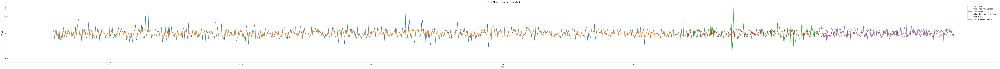

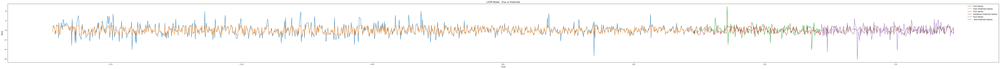

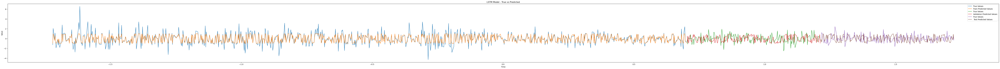

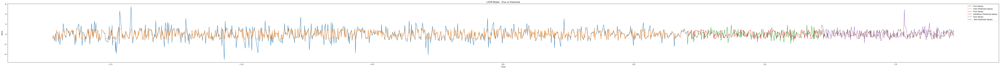

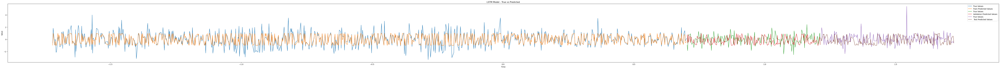

...

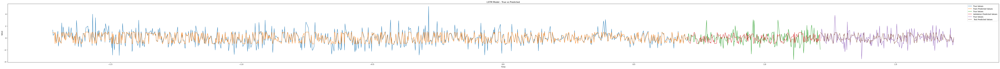

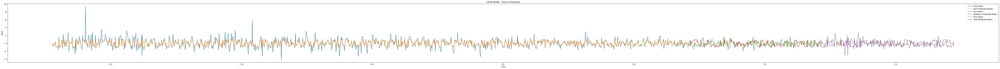

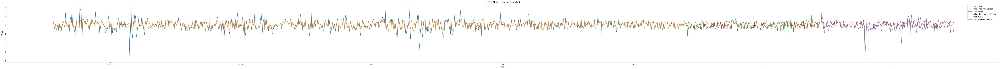

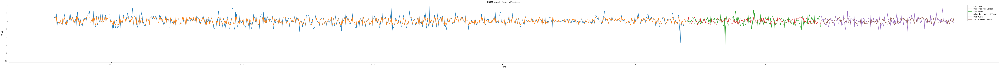

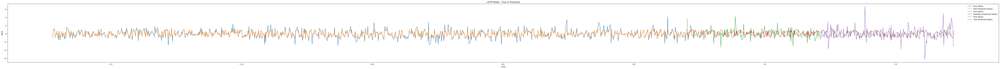

In [98]:
split_train_targets = np.array_split(train_targets,len(train_pred[0]),axis=1)
split_train_pred = np.array_split(train_pred,len(train_pred[0]),axis=1)
split_validation_targets = np.array_split(validation_targets,len(validation_pred[0]),axis=1)
split_validation_pred = np.array_split(validation_pred,len(validation_pred[0]),axis=1)
split_test_targets = np.array_split(test_targets,len(test_pred[0]),axis=1)
split_test_pred = np.array_split(test_pred,len(test_pred[0]),axis=1)


print(len(targets))
print(train_pred)
print(split_train_targets)

for i in range(len(best_options)):
    plt.figure(i,figsize=(100, 6))
    plt.plot(df_stocks['date'][rwin:rwin+len(train_targets)], split_train_targets[i], label='True Values')
    plt.plot(df_stocks['date'][rwin:rwin+len(train_targets)], split_train_pred[i], label='Train Predicted Values')
    plt.plot(df_stocks['date'][rwin+len(train_targets):rwin+len(train_targets)+len(validation_targets)], split_validation_targets[i], label='True Values')
    plt.plot(df_stocks['date'][rwin+len(train_targets):rwin+len(train_targets)+len(validation_targets)], split_validation_pred[i], label='Validation Predicted Values')
    plt.plot(df_stocks['date'][rwin+1+len(train_targets)+len(validation_targets):], split_test_targets[i], label='True Values')
    plt.plot(df_stocks['date'][rwin+len(train_targets)+len(validation_targets):], split_test_pred[i][:-1], label=' Test Predicted Values')
    plt.title('LSTM Model - True vs Predicted')
    plt.xlabel('Time')
    plt.ylabel('Value')
    plt.legend()
    plt.show()